## Introduction 

Hello! This is my very first Kernel. It is meant to give a grasp of a problem of speech representation. I'd also like to take a look on a features specific to this dataset. 

Content:<br>
* [1. Visualization of the recordings - input features](#visualization)
   * [1.1. Wave and spectrogram](#waveandspectrogram)
   * [1.2. MFCC](#mfcc)
   * [1.3. Sprectrogram in 3d](#3d)
   * [1.4. Silence removal](#resampl)
   * [1.5. Resampling - dimensionality reductions](#silenceremoval)
   * [1.6. Features extraction steps](#featuresextractionsteps)
* [2. Dataset investigation](#investigations)
   * [2.1. Number of files](#numberoffiles)
   * [2.2. Mean spectrograms and fft](#meanspectrogramsandfft)
   * [2.3. Deeper into recordings](#deeper)
   * [2.4. Length of recordings](#len)
   * [2.5. Note on Gaussian Mixtures modeling](#gmms)
   * [2.6. Frequency components across the words](#components)
   * [2.7. Anomaly detection](#anomaly)
* [3. Where to look for the inspiration](#wheretostart)

All we need is here:

## 데이터의 특징

총 65,000개의 1초 내외의 음성파일

- 31개 폴더 : "Yes", "No", "Up", "Down", "Left", "Right", "On", "Off", "Stop", "Go", "Zero", "One", "Two", "Three", "Four", "Five", "Six", "Seven", "Eight", "Nine", "Bed", "Bird", "Cat", "Dog", "Happy", "House", "Marvin", "Sheila", "Tree", "Wow", "_background_noise_"존재 </br>



- 20개 core words : "Yes", "No", "Up", "Down", "Left", "Right", "On", "Off", "Stop", "Go", "Zero", "One", "Two", "Three", "Four", "Five", "Six", "Seven", "Eight", and "Nine"</br>


- 나머지 10개가 auxiliary words : "_background_noise_"는 제외  : 보조단어</br>


- core words 중 "Yes", "No", "Up", "Down", "Left", "Right", "On", "Off", "Stop", "Go"가 Test에서 예측을 위해 쓰임

In [1]:
import py7zr

import os
for dirname, _, filenames in os.walk('./input/'):
    for filename in filenames:
        print(os.path.join(dirname, filename))
        
if not os.path.exists('./input/train/') :
    os.makedirs('./input/train/')

if not os.path.exists('./input/test/') :
    os.makedirs('./input/test/')

with py7zr.SevenZipFile("./input/train.7z", 'r') as archive:
    archive.extractall(path="./input/train/")

with py7zr.SevenZipFile("./input/test.7z", 'r') as archive:
    archive.extractall(path="./input/test/")

for dirname, _, filenames in os.walk('./input/'): 
    for filename in filenames: 
        print(os.path.join(dirname, filename))

./input/link_to_gcp_credits_form.txt
./input/sample_submission.7z
./input/test.7z
./input/train.7z
./input/보조.ipynb
./input/.ipynb_checkpoints\보조-checkpoint.ipynb
./input/link_to_gcp_credits_form.txt
./input/sample_submission.7z
./input/test.7z
./input/train.7z
./input/보조.ipynb
./input/.ipynb_checkpoints\보조-checkpoint.ipynb
./input/test\test\audio\clip_000044442.wav
./input/test\test\audio\clip_0000adecb.wav
./input/test\test\audio\clip_0000d4322.wav
./input/test\test\audio\clip_0000fb6fe.wav
./input/test\test\audio\clip_0001d1559.wav
./input/test\test\audio\clip_0002256ed.wav
./input/test\test\audio\clip_0002a4a1f.wav
./input/test\test\audio\clip_0002d9b83.wav
./input/test\test\audio\clip_000373a5b.wav
./input/test\test\audio\clip_0003c7122.wav
./input/test\test\audio\clip_0003e6aee.wav
./input/test\test\audio\clip_00049951d.wav
./input/test\test\audio\clip_0004c6707.wav
./input/test\test\audio\clip_0004f8b63.wav
./input/test\test\audio\clip_00068e281.wav
./input/test\test\audio\clip_

In [2]:
!pip install librosa

  Created wheel for audioread: filename=audioread-2.1.9-py3-none-any.whl size=23154 sha256=302a684b4e77df272d4b4811e0b4e8ba85a9598b0198ec7043b299da774fba62
  Stored in directory: c:\users\home\appdata\local\pip\cache\wheels\a2\a3\bd\ec1568ce7515115a11ab686d509ad302124c782af065de47ee
  Created wheel for resampy: filename=resampy-0.2.2-py3-none-any.whl size=320731 sha256=b9c8577efbb9c6c13842da65198ca26606ada0721ee1eeba0bbdb6a5f0e58659
  Stored in directory: c:\users\home\appdata\local\pip\cache\wheels\86\2c\7d\46a32a246b0e5939cea2c5ec1492164073e0c5d16d666ae2cd
Successfully built audioread resampy


In [2]:
import os
from os.path import isdir, join
from pathlib import Path
import pandas as pd

# Math
import numpy as np
from scipy.fftpack import fft # fast-fourier transforms
from scipy import signal
from scipy.io import wavfile
import librosa # librosa는 음악 및 오디오 분석을 위한 파이썬 패키지입니다. 음악 정보 검색 시스템을 만드는 데 필요한 구성 요소를 제공합니다.


from sklearn.decomposition import PCA

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
import IPython.display as ipd
import librosa.display

import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls
import pandas as pd

%matplotlib inline


# 1. Visualization 
<a id="visualization"></a> 

There are two theories of a human hearing - place ( https://en.wikipedia.org/wiki/Place_theory_(hearing) (frequency-based) and temporal (https://en.wikipedia.org/wiki/Temporal_theory_(hearing) )
In speech recognition, I see two main tendencies - to input [spectrogram](https://en.wikipedia.org/wiki/Spectrogram) (frequencies), and more sophisticated features MFCC - Mel-Frequency Cepstral Coefficients, PLP. You rarely work with raw, temporal data.

Let's visualize some recordings!

## 1.1. Wave and spectrogram:
<a id="waveandspectrogram"></a> 

Choose and read some file:

In [3]:
train_audio_path = './input/train/train/audio/'
filename = 'yes/0a7c2a8d_nohash_0.wav'
sample_rate, samples = wavfile.read(str(train_audio_path) + filename) # sample_rate = 160000Hz

In [4]:
print(sample_rate) 

16000


In [5]:
print(samples)

[ 14  -7 -14 ...  19  20  27]


스펙트로그램을 계산하는 함수를 정의합니다.

참고: 스펙트로그램 값의 대수를 취합니다. 그러면 우리의 줄거리가 훨씬 더 분명해질 것이고, 게다가 그것은 사람들이 듣는 방식과 엄격히 연결되어 있습니다.
로그 입력값으로 0이 없음을 확인해야 합니다.

이 음성 파일을 시각화하여 살펴보자. 음성은 시간, 주파수, 진폭(amplitude)으로 이루어져 있다. 하지만 단순하게 spectrum 그래프를 그리면 이 세 가지 요소를 동시에 살펴볼 수 없다. 그래서 신호의 spectral content의 시간 변위를 표시하는 시간, 주파수에 대한 2차 함수인 Spectrogram을 계산해야 한다.



In [6]:
def log_specgram(audio, sample_rate, window_size=20,
                 step_size=10, eps=1e-10):
    # nperseg: Length of each segment
    # noverlap: 세그먼트 간에 겹칠 점 수입니다.
    nperseg = int(round(window_size * sample_rate / 1e3)) # 320
    noverlap = int(round(step_size * sample_rate / 1e3)) # 160
    freqs, times, spec = signal.spectrogram(audio,
                                    fs=sample_rate,
                                    window='hann',
                                    nperseg=nperseg,
                                    noverlap=noverlap,
                                    detrend=False)
    return freqs, times, np.log(spec.T.astype(np.float32) + eps)

In [7]:
1e3

1000.0

In [8]:
nperseg = int(round(20 * sample_rate / 1e3))
nperseg

320

In [9]:
noverlap = int(round(10 * sample_rate / 1e3))
noverlap

160

Frequencies are in range (0, 8000) according to [Nyquist theorem](https://en.wikipedia.org/wiki/Nyquist_rate).

Let's plot it:

Amplitude, Spectrogram plot 그리기

Text(0.5, 0, 'Seconds')

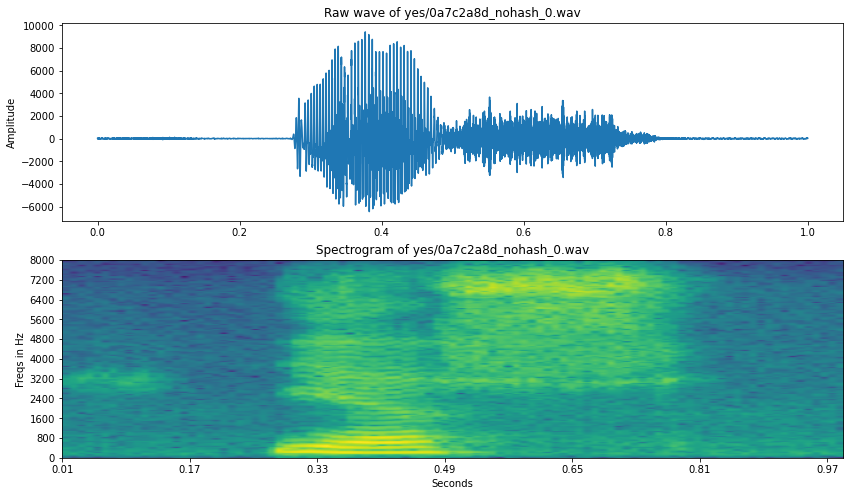

In [10]:
freqs, times, spectrogram = log_specgram(samples, sample_rate)

fig = plt.figure(figsize=(14, 8))

# amplitude(y) + time(x)시간 파형
ax1 = fig.add_subplot(211)
ax1.set_title('Raw wave of ' + filename)
ax1.set_ylabel('Amplitude')
ax1.plot(np.linspace(0, sample_rate/len(samples), sample_rate), samples)

# freq(y)주파수 + times(x)시간 + amplitude(z)진폭 스펙트로그램
ax2 = fig.add_subplot(212)
ax2.imshow(spectrogram.T, aspect='auto', origin='lower', 
           extent=[times.min(), times.max(), freqs.min(), freqs.max()])

ax2.set_yticks(freqs[::16])
ax2.set_xticks(times[::16])
ax2.set_title('Spectrogram of ' + filename)
ax2.set_ylabel('Freqs in Hz')
ax2.set_xlabel('Seconds')

In [11]:
freqs, times, spectrogram = log_specgram(samples, sample_rate)
print(freqs, times, spectrogram)

[   0.   50.  100.  150.  200.  250.  300.  350.  400.  450.  500.  550.
  600.  650.  700.  750.  800.  850.  900.  950. 1000. 1050. 1100. 1150.
 1200. 1250. 1300. 1350. 1400. 1450. 1500. 1550. 1600. 1650. 1700. 1750.
 1800. 1850. 1900. 1950. 2000. 2050. 2100. 2150. 2200. 2250. 2300. 2350.
 2400. 2450. 2500. 2550. 2600. 2650. 2700. 2750. 2800. 2850. 2900. 2950.
 3000. 3050. 3100. 3150. 3200. 3250. 3300. 3350. 3400. 3450. 3500. 3550.
 3600. 3650. 3700. 3750. 3800. 3850. 3900. 3950. 4000. 4050. 4100. 4150.
 4200. 4250. 4300. 4350. 4400. 4450. 4500. 4550. 4600. 4650. 4700. 4750.
 4800. 4850. 4900. 4950. 5000. 5050. 5100. 5150. 5200. 5250. 5300. 5350.
 5400. 5450. 5500. 5550. 5600. 5650. 5700. 5750. 5800. 5850. 5900. 5950.
 6000. 6050. 6100. 6150. 6200. 6250. 6300. 6350. 6400. 6450. 6500. 6550.
 6600. 6650. 6700. 6750. 6800. 6850. 6900. 6950. 7000. 7050. 7100. 7150.
 7200. 7250. 7300. 7350. 7400. 7450. 7500. 7550. 7600. 7650. 7700. 7750.
 7800. 7850. 7900. 7950. 8000.] [0.01 0.02 0.03 0.0

NN의 입력 기능으로 스펙트로그램을 사용하는 경우 기능을 정규화하는 것을 기억해야 합니다. (모든 데이터셋을 정규화해야 합니다. 이 예에서는 평균과 표준이 적절하지 않은 한 데이터셋을 예로 들어 보겠습니다.)


In [12]:
mean = np.mean(spectrogram, axis=0)
std = np.std(spectrogram, axis=0)
spectrogram = (spectrogram - mean) / std

짚고 넘어가야 할 흥미로운 사실이 있습니다. 각 프레임에는 최대 160개의 기능이 있으며 주파수는 0에서 8000 사이입니다. 즉, 하나의 기능이 50Hz에 해당합니다. 그러나 [귀의 주파수 분해능은 1000 – 2000Hz 옥타브 내에서 3.6Hz입니다](https://en.wikipedia.org/wiki/Psychoacoustics) 이것은 사람들이 위와 같은 스펙트로그램으로 표현되는 것보다 훨씬 더 정확하고 더 작은 세부사항을 들을 수 있다는 것을 의미합니다.


## 1.2. MFCC
<a id="mfcc"></a> 

MFCC에 대한 자세한 내용은 이 튜토리얼을 참조하십시오. MFCC는 인간의 청력을 흉내낼 준비가 잘 되어 있다는 것을 알 수 있습니다.
. [MFCC explained](http://practicalcryptography.com/miscellaneous/machine-learning/guide-mel-frequency-cepstral-coefficients-mfccs/) 

*librosa* python 패키지를 사용하여 *Mel 파워 스펙트로그램* 및 *MFCC*를 계산할 수 있습니다.


C:\Users\HOME\AppData\Local\Temp/ipykernel_10000/1573907773.py:6: FutureWarning:

Pass y=[ 4.0688968e-04  3.1694559e-05 -4.5456085e-04 ...  5.9469097e-04
  8.1928732e-04  6.3908176e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error



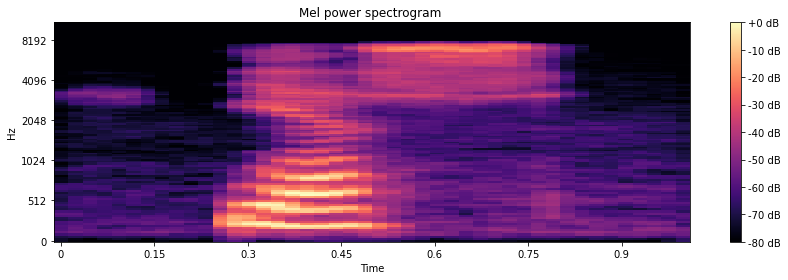

In [13]:
# From this tutorial
# https://github.com/librosa/librosa/blob/master/examples/LibROSA%20demo.ipynb
# librosa는 음악 및 오디오 분석을 위한 파이썬 패키지입니다. 음악 정보 검색 시스템을 만드는 데 필요한 구성 요소를 제공합니다.
samples, sample_rate = librosa.load(str(train_audio_path)+filename)

S = librosa.feature.melspectrogram(samples, sr=sample_rate, n_mels=128)

# 로그 척도(dB)로 변환합니다. 피크 전력(최대)을 기준으로 사용합니다.
log_S = librosa.power_to_db(S, ref=np.max)

plt.figure(figsize=(12, 4))
librosa.display.specshow(log_S, sr=sample_rate, x_axis='time', y_axis='mel')
plt.title('Mel power spectrogram ')
plt.colorbar(format='%+02.0f dB')
plt.tight_layout()

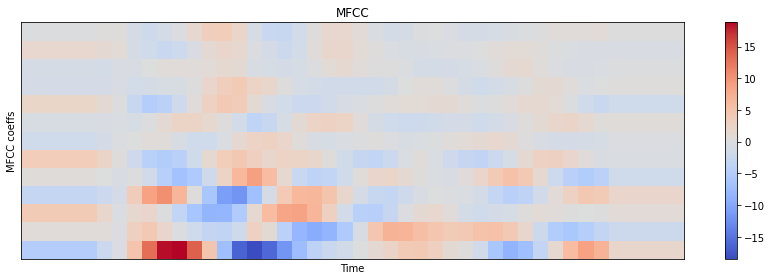

In [14]:
mfcc = librosa.feature.mfcc(S=log_S, n_mfcc=13)

# Let's pad on the first and second deltas while we're at it
delta2_mfcc = librosa.feature.delta(mfcc, order=2)

plt.figure(figsize=(12, 4))
librosa.display.specshow(delta2_mfcc)
plt.ylabel('MFCC coeffs')
plt.xlabel('Time')
plt.title('MFCC')
plt.colorbar()
plt.tight_layout()

고전적이지만 여전히 최첨단 시스템에서는 *MFCC* 또는 이와 유사한 기능이 스펙트로그램 대신 시스템에 입력되는 것으로 간주됩니다.

그러나 엔드 투 엔드(종종 뉴럴 네트워크 기반) 시스템에서 가장 일반적인 입력 기능은 원시 스펙트로그램 또는 멜 파워 스펙트로그램일 것입니다. 예를 들어 *MFCC*는 피쳐를 장식하지만 NN은 상관된 피쳐를 잘 처리합니다. 또한, 만약 여러분이 멜 필터를 이해한다면, 여러분은 멜 필터의 사용이 합리적이라고 생각할 수 있습니다.a

어느 쪽을 선택할지는 당신의 결정입니다!

## 1.3. Spectrogram in 3d
<a id="3d"></a> 

By the way, times change, and the tools change. Have you ever seen spectrogram in 3d?

하지만 많은 좋은 tool이 나와서 다음과 같이 3D 그래프로도 그릴 수 있게 되었다.



In [15]:
data = [go.Surface(x=times, y=freqs, z=spectrogram.T)]

layout = go.Layout(
    title='Specgtrogram of "yes" in 3d',
    scene = dict(
    yaxis = dict(title='Frequencies', range=[freqs.min(),freqs.max()]),
    xaxis = dict(title='Time', range=[times.min(),times.max()],),
    zaxis = dict(title='Log amplitude'),
    ),
)

fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

(축 범위를 적절한 값으로 설정하는 방법은 아직 모릅니다. 위에 있는 전형적인 스펙트로그램처럼 줄무늬가 있었으면 합니다.


## 1.4. Silence removal
<a id="silenceremoval"></a> 

Let's listen to that file

In [16]:
ipd.Audio(samples, rate=sample_rate)

여기서는 *VAD*(음성 활동 탐지)가 매우 유용할 것으로 생각합니다. 짧은 말이지만, 그 말 속에는 많은 침묵이 담겨 있습니다. 적절한 *VAD*는 교육 규모를 크게 줄여 교육 속도를 크게 높일 수 있습니다.
파일의 처음부터 끝까지 일부를 잘라낸 후 다시 들어보겠습니다(위의 플롯을 기준으로 하면 4000에서 13000으로 이동합니다).


In [17]:
samples_cut = samples[4000:13000]
ipd.Audio(samples_cut, rate=sample_rate)

우리는 전체 단어를 들을 수 있다는 것에 동의할 수 있습니다. 모든 파일을 수동으로 자르고 간단한 플롯을 기반으로 하는 것은 불가능합니다. 그러나 *webrtcvad* 패키지를 사용하여 양호한 *VAD*를 만들 수 있습니다.

'y' 'e' 's'* 그래피의 예상 정렬과 함께 다시 플롯해 보겠습니다.

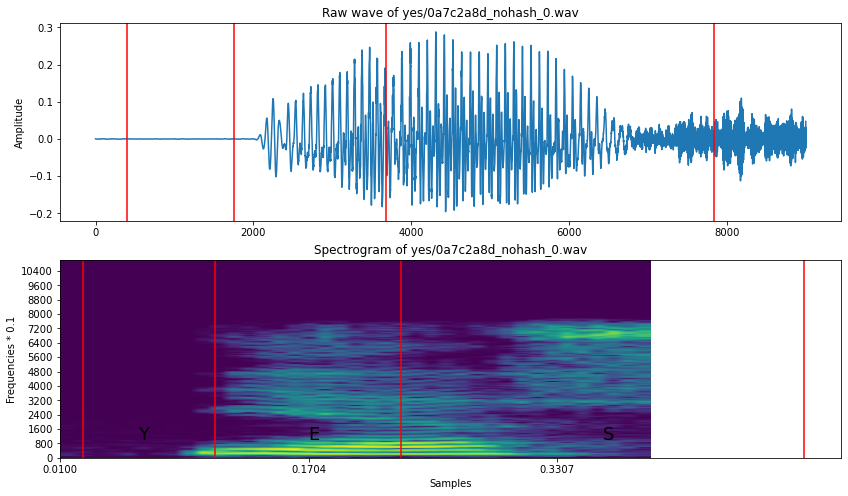

In [18]:
freqs, times, spectrogram_cut = log_specgram(samples_cut, sample_rate)

fig = plt.figure(figsize=(14, 8))
ax1 = fig.add_subplot(211)
ax1.set_title('Raw wave of ' + filename)
ax1.set_ylabel('Amplitude')
ax1.plot(samples_cut)

ax2 = fig.add_subplot(212)
ax2.set_title('Spectrogram of ' + filename)
ax2.set_ylabel('Frequencies * 0.1')
ax2.set_xlabel('Samples')
ax2.imshow(spectrogram_cut.T, aspect='auto', origin='lower', 
           extent=[times.min(), times.max(), freqs.min(), freqs.max()])
ax2.set_yticks(freqs[::16])
ax2.set_xticks(times[::16])

ax2.text(0.06, 1000, 'Y', fontsize=18)
ax2.text(0.17, 1000, 'E', fontsize=18)
ax2.text(0.36, 1000, 'S', fontsize=18)

xcoords = [0.025, 0.11, 0.23, 0.49]
for xc in xcoords:
    ax1.axvline(x=xc*16000, c='r')
    ax2.axvline(x=xc, c='r')

## 1.5. Resampling - dimensionality reduction
<a id="resampl"></a> 

데이터의 차원을 줄이는 또 다른 방법은 기록을 다시 샘플로 만드는 것입니다.

녹음은 16k 주파수로 샘플링되기 때문에 자연스럽지 않게 들립니다. 그리고 우리는 보통 훨씬 더 많이 듣습니다. 그러나, [가장 많은 음성 관련 주파수는 더 작은 대역으로 표시됩니다](https://en.wikipedia.org/wiki/Voice_frequency) 그렇기 때문에 GSM 신호가 8000Hz로 샘플링되는 다른 사람이 전화하는 것을 여전히 이해할 수 있습니다.

요약하자면, 데이터 세트를 8k로 다시 샘플링할 수 있습니다. 중요하지 않은 정보는 폐기하고 데이터 크기를 줄일 것입니다.

이는 경쟁이기 때문에 위험할 수 있으며 때로는 성능의 차이가 매우 작기 때문에 어떤 것도 잃고 싶지 않다는 점을 기억해야 합니다. 반면, 첫 번째 실험은 더 작은 훈련 크기로 훨씬 더 빠르게 수행될 수 있습니다.

FFT(Fast Fourier Transform)를 계산해야 합니다. 정의는 다음과 같습니다.



In [19]:
def custom_fft(y, fs): # y=samples, fs=sample_rate
    T = 1.0 / fs # 1/160000
    N = y.shape[0] # 160000
    yf = fft(y) # 160000
    xf = np.linspace(0.0, 1.0/(2.0*T), N//2)
    vals = 2.0/N * np.abs(yf[0:N//2])  # FFT is simmetrical, so we take just the first half
    # FFT is also complex, to we take just the real part (abs)
    return xf, vals

In [48]:
samples

array([ 13,  21,  27, ..., -19, -16, -18], dtype=int16)

In [47]:
fft(samples)

array([ -956.            -0.j        , 14045.98236472 +6651.55020452j,
       23094.65028573-17758.83341632j, ...,
       -6620.33265171+32246.16118847j, 23094.65028573+17758.83341632j,
       14045.98236472 -6651.55020452j])

녹음한 거 읽고 다시 샘플링하고 들어볼까요? 또한 FFT를 비교할 수 있습니다. 원래 신호에는 4000Hz 이상의 정보가 거의 없습니다.


In [20]:
filename = '/happy/0b09edd3_nohash_0.wav'
new_sample_rate = 8000

sample_rate, samples = wavfile.read(str(train_audio_path) + filename)
resampled = signal.resample(samples, int(new_sample_rate/sample_rate * samples.shape[0])) # (16000, 8000) -> (8000, )

In [21]:
ipd.Audio(samples, rate=sample_rate)

In [22]:
ipd.Audio(resampled, rate=new_sample_rate)

Almost no difference!

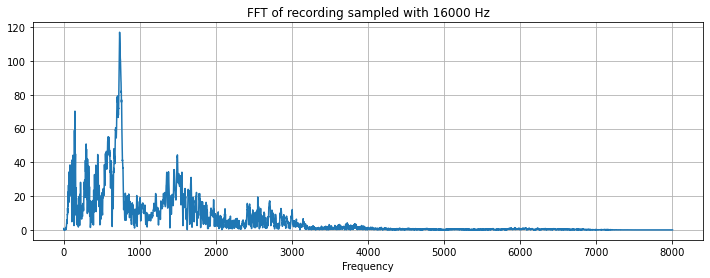

In [23]:
xf, vals = custom_fft(samples, sample_rate)
plt.figure(figsize=(12, 4))
plt.title('FFT of recording sampled with ' + str(sample_rate) + ' Hz')
plt.plot(xf, vals)
plt.xlabel('Frequency')
plt.grid()
plt.show()

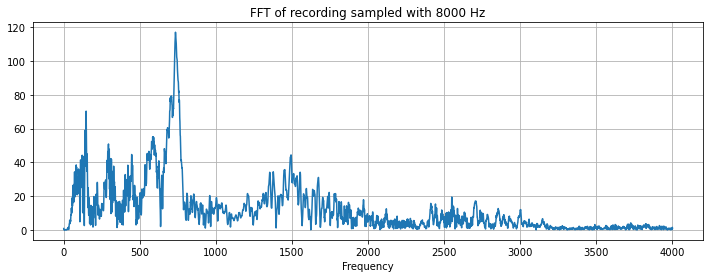

In [24]:
xf, vals = custom_fft(resampled, new_sample_rate)
plt.figure(figsize=(12, 4))
plt.title('FFT of recording sampled with ' + str(new_sample_rate) + ' Hz')
plt.plot(xf, vals)
plt.xlabel('Frequency')
plt.grid()
plt.show()

This is how we reduced dataset size twice!

## 1.6. Features extraction steps
<a id="featuresextractionsteps"></a> 

특징 추출 알고리즘을 다음과 같이 제안합니다.
1. 재샘플링을 합니다.
2. *VAD*입니다.
3. 신호 길이가 같도록 0으로 채웁니다.
4. 스펙트로그램(또는 *MFCC* 또는 *PLP*)을 기록합니다.
5. *mean* 및 *std*를 사용한 정규화를 특징으로 합니다.
6. 주어진 수의 프레임을 쌓아서 시간 정보를 얻습니다.

노트북으로는 할 수 없는 게 아쉽네요. 0부터 쓰는 것은 의미가 없으며, 커널에서 가져올 수 없는 모든 것을 패키지로 가져올 준비가 되어 있습니다.



# 2. Dataset investigation
<a id="investigations"></a> 

Some usuall investgation of dataset.

## 2.1. Number of records
<a id="numberoffiles"></a> 


In [25]:
dirs = [f for f in os.listdir(train_audio_path) if isdir(join(train_audio_path, f))]
dirs.sort()
print('Number of labels: ' + str(len(dirs)))

Number of labels: 31


In [26]:
# Calculate
number_of_recordings = []
for direct in dirs:
    waves = [f for f in os.listdir(join(train_audio_path, direct)) if f.endswith('.wav')]
    number_of_recordings.append(len(waves))

# Plot
data = [go.Histogram(x=dirs, y=number_of_recordings)]
trace = go.Bar(
    x=dirs,
    y=number_of_recordings,
    marker=dict(color = number_of_recordings, showscale=True
    ),
)

layout = go.Layout(
    title='Number of recordings in given label',
    xaxis = dict(title='Words'),
    yaxis = dict(title='Number of recordings')
)

py.iplot(go.Figure(data=[trace], layout=layout))

데이터 집합은 background_noise를 제외하고 균형을 이루지만, 이는 다른 점입니다.


## 2.2. Deeper into recordings
<a id="deeper"></a> 

아주 중요한 사실이 있다. 녹음은 매우 다른 출처에서 나온다. 내가 알기로는, 그들 중 일부는 이동형 GSM 채널에서 올 수 있다.

그럼에도 불구하고, 한명의 발화자가 test 와 train data으로 분리 되지 않는 것이 매우 중요하다. 이 두 가지 시험 유형을 보고 들어 보자

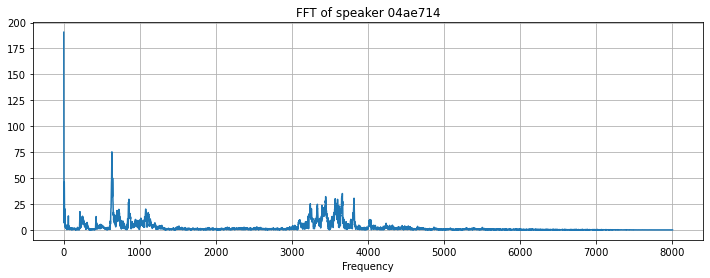

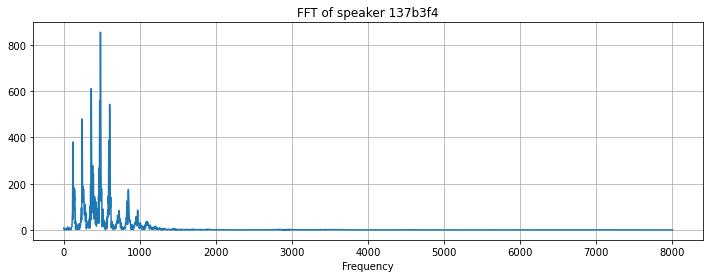

In [27]:
filenames = ['on/004ae714_nohash_0.wav', 'on/0137b3f4_nohash_0.wav']
for filename in filenames:
    sample_rate, samples = wavfile.read(str(train_audio_path) + filename)
    xf, vals = custom_fft(samples, sample_rate)
    
    plt.figure(figsize=(12, 4))
    plt.title('FFT of speaker ' + filename[4:11])
    plt.plot(xf, vals)
    plt.xlabel('Frequency')
    plt.grid()
    plt.show()

In [28]:
xf, vals = custom_fft(samples, sample_rate)
print(xf)
print(vals)

[0.00000000e+00 1.00012502e+00 2.00025003e+00 ... 7.99799975e+03
 7.99899987e+03 8.00000000e+03]
[8.67325000e+00 7.69734280e+00 5.51485400e+00 ... 5.22487166e-03
 2.64463522e-03 5.65279979e-03]


Even better to listen:

In [29]:
filenames = ['on/004ae714_nohash_0.wav', 'on/0137b3f4_nohash_0.wav']
print('Speaker ' + filenames[0][4:11])
ipd.Audio(join(train_audio_path, filenames[0]))

Speaker 04ae714


In [30]:
print('Speaker ' + filenames[1][4:11])
ipd.Audio(join(train_audio_path, filenames[1]))

Speaker 137b3f4


아래 녹음에는 이상한 침묵이 있다. 아마 압축하는 과정에서 생겼을수도 있다.



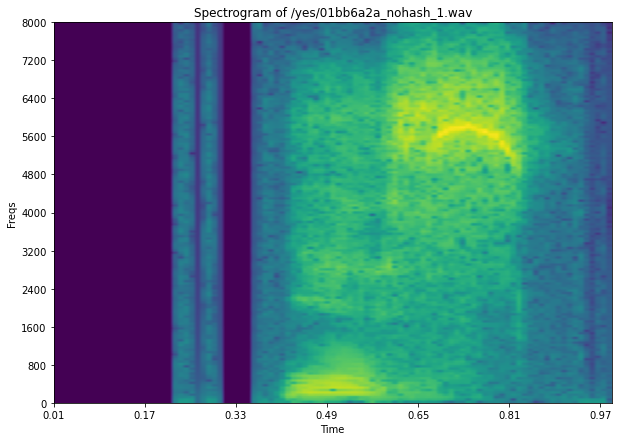

In [31]:
filename = '/yes/01bb6a2a_nohash_1.wav'
sample_rate, samples = wavfile.read(str(train_audio_path) + filename)
freqs, times, spectrogram = log_specgram(samples, sample_rate)

plt.figure(figsize=(10, 7))
plt.title('Spectrogram of ' + filename)
plt.ylabel('Freqs')
plt.xlabel('Time')
plt.imshow(spectrogram.T, aspect='auto', origin='lower', 
           extent=[times.min(), times.max(), freqs.min(), freqs.max()])
plt.yticks(freqs[::16])
plt.xticks(times[::16])
plt.show()

즉, 우리는 매우 특정한 음향 환경에서 과도하게 적응하는 것을 막아야 한다.



## 2.3. Recordings length
<a id="len"></a> 

모든 파일이 1초로 구성되어 있는지 확인해보자.



In [32]:
num_of_shorter = 0

for direct in dirs:
    waves = [f for f in os.listdir(join(train_audio_path, direct)) if f.endswith('.wav')]
    for wav in waves:
        sample_rate, samples = wavfile.read(train_audio_path + direct + '/' + wav)
        if samples.shape[0] < sample_rate:
            num_of_shorter += 1
            
print('Number of recordings shorter than 1 second: ' + str(num_of_shorter))

C:\Users\HOME\AppData\Local\Temp/ipykernel_10000/1275806195.py:6: WavFileWarning:

Chunk (non-data) not understood, skipping it.



Number of recordings shorter than 1 second: 6469


놀랍게도 많은 데이터들이 0에 가까운 파일 시간을 가지고 있다.



## 2.4. Mean spectrograms and FFT
<a id="meanspectrogramsandfft"></a> 

모든 단어의 mean FFT plot을 보자.



['down', 'go', 'left', 'no', 'off', 'on', 'right', 'stop', 'up', 'yes']


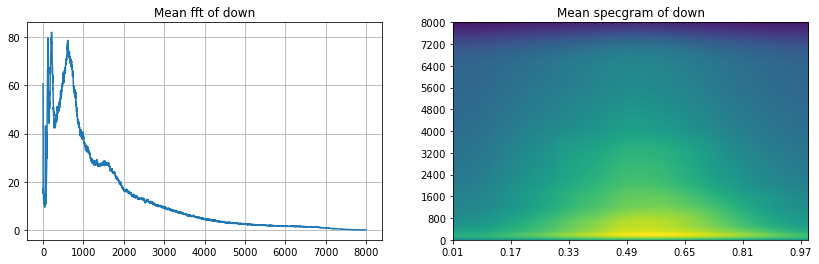

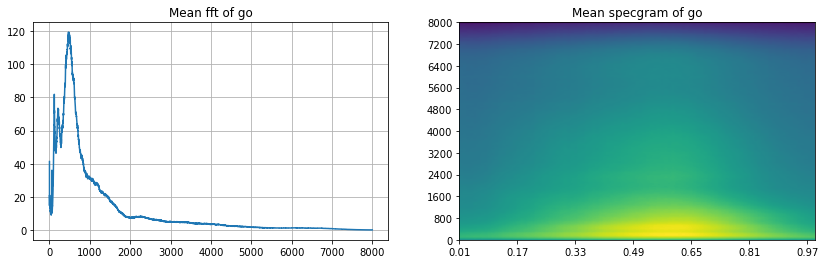

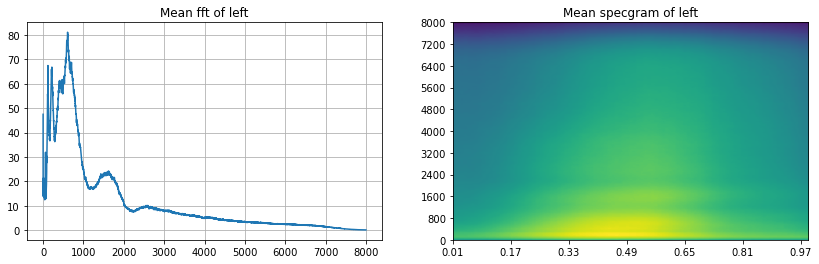

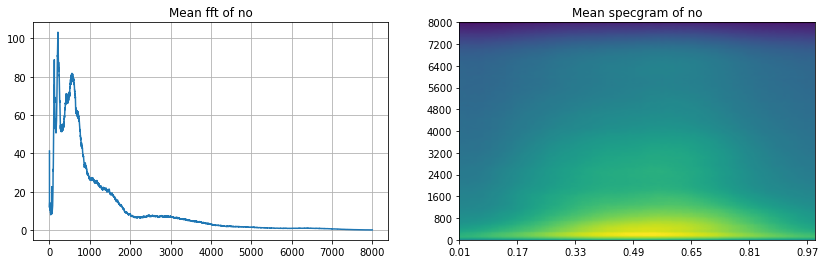

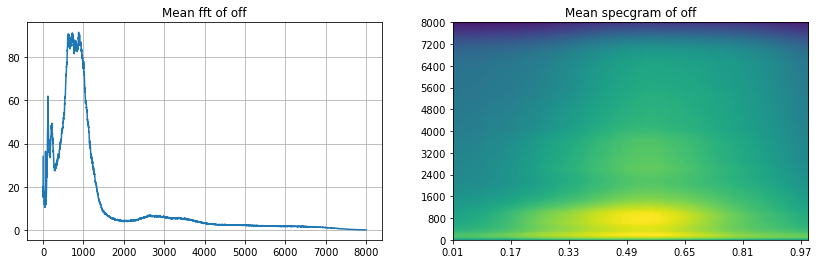

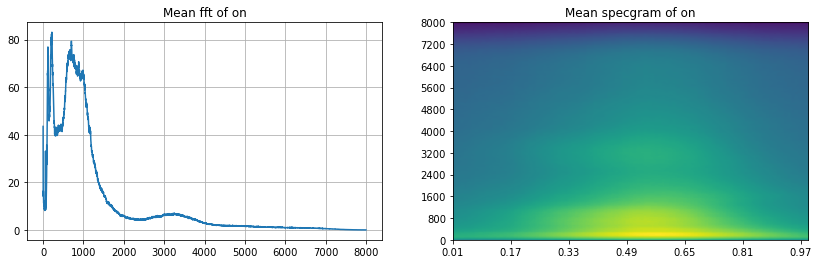

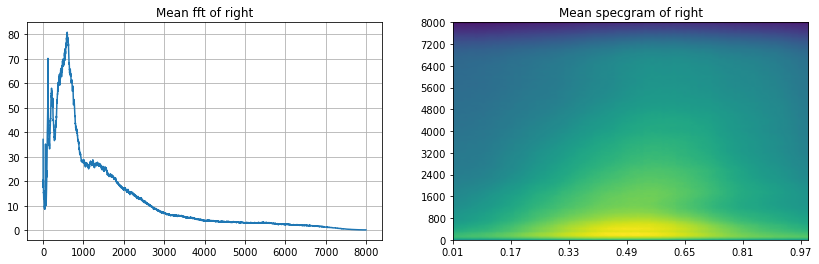

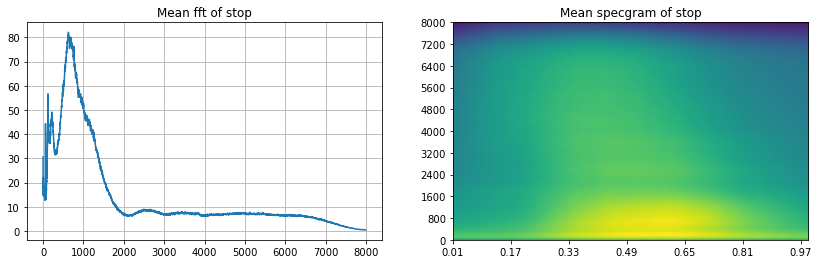

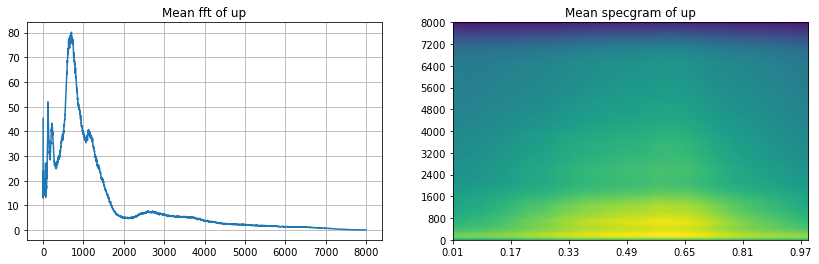

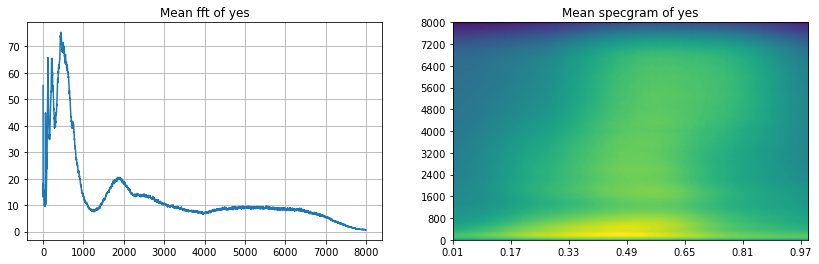

In [33]:
to_keep = 'yes no up down left right on off stop go'.split()
dirs = [d for d in dirs if d in to_keep]

print(dirs)

for direct in dirs:
    vals_all = []
    spec_all = []

    waves = [f for f in os.listdir(join(train_audio_path, direct)) if f.endswith('.wav')]
    for wav in waves:
        sample_rate, samples = wavfile.read(train_audio_path + direct + '/' + wav)
        if samples.shape[0] != 16000:
            continue
        xf, vals = custom_fft(samples, 16000)
        vals_all.append(vals)
        freqs, times, spec = log_specgram(samples, 16000)
        spec_all.append(spec)

    plt.figure(figsize=(14, 4))
    plt.subplot(121)
    plt.title('Mean fft of ' + direct)
    plt.plot(np.mean(np.array(vals_all), axis=0))
    plt.grid()
    plt.subplot(122)
    plt.title('Mean specgram of ' + direct)
    plt.imshow(np.mean(np.array(spec_all), axis=0).T, aspect='auto', origin='lower', 
               extent=[times.min(), times.max(), freqs.min(), freqs.max()])
    plt.yticks(freqs[::16])
    plt.xticks(times[::16])
    plt.show()

## 2.5. Gaussian Mixtures modeling
<a id="gmms"></a> 

각 단어마다 평균 FFT가 다르게 보인다는 것을 알 수 있습니다. 가우스 분포의 혼합으로 각 FFT를 모델링할 수 있습니다. 그러나 일부 FFT에서는 *stop* 및 *up*과 같이 거의 동일하게 보입니다. 하지만 잠깐, 스펙트로그램을 보면 그것들은 여전히 구별이 돼요! *stop*(아마 *s*) 시작 시 고주파수는 로우보다 빠릅니다.

그래서 시간적 구성 요소도 필요합니다 GMM으로 단어(또는 단어의 작은 부분)를 모델링하고 [Hidden Markov Models](https://github.com/danijel3/ASRDemos/blob/master/notebooks/HMM_FST.ipynb))로 시간 종속성을 모델링할 수 있는 [Kaldi](http://kaldi-asr.org/) 라이브러리)가 있습니다.

단어에 간단한 GMM을 사용하여 무엇을 모델링할 수 있는지, 단어를 구분하는 것이 얼마나 어려운지를 확인할 수 있습니다. [Scikit-learn](http://scikit-learn.org/))을 이용하면 되지만, 간단하지 않고 오래 지속되기 때문에 일단 이 아이디어를 포기하겠습니다.

## 2.6. Frequency components across the words
<a id="components"></a> 


In [34]:
def violinplot_frequency(dirs, freq_ind):
    """ Plot violinplots for given words (waves in dirs) and frequency freq_ind
    from all frequencies freqs."""

    spec_all = []  # Contain spectrograms
    ind = 0
    for direct in dirs:
        spec_all.append([])

        waves = [f for f in os.listdir(join(train_audio_path, direct)) if
                 f.endswith('.wav')]
        for wav in waves[:100]:
            sample_rate, samples = wavfile.read(
                train_audio_path + direct + '/' + wav)
            freqs, times, spec = log_specgram(samples, sample_rate)
            spec_all[ind].extend(spec[:, freq_ind])
        ind += 1

    # Different lengths = different num of frames. Make number equal
    minimum = min([len(spec) for spec in spec_all])
    spec_all = np.array([spec[:minimum] for spec in spec_all])

    plt.figure(figsize=(13,7))
    plt.title('Frequency ' + str(freqs[freq_ind]) + ' Hz')
    plt.ylabel('Amount of frequency in a word')
    plt.xlabel('Words')
    sns.violinplot(data=pd.DataFrame(spec_all.T, columns=dirs))
    plt.show()

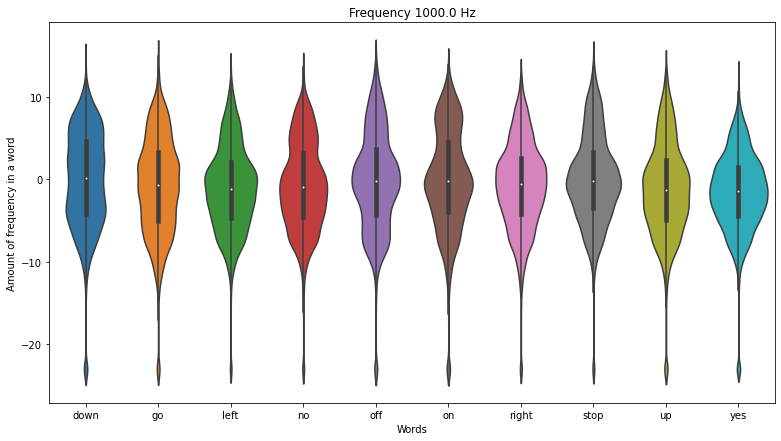

In [35]:
violinplot_frequency(dirs, 20)

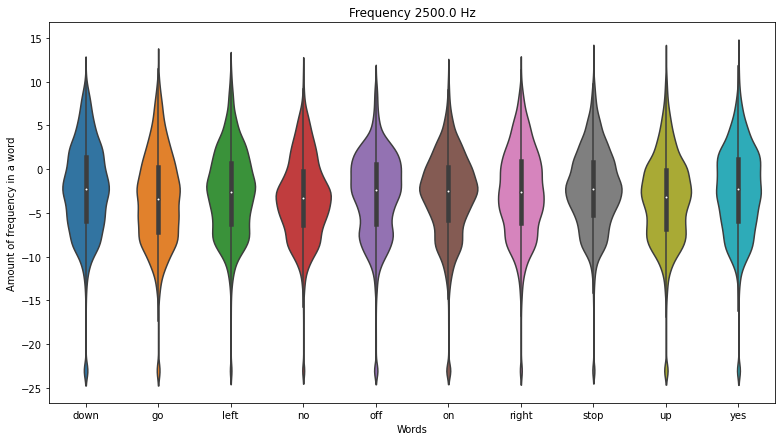

In [36]:
violinplot_frequency(dirs, 50)

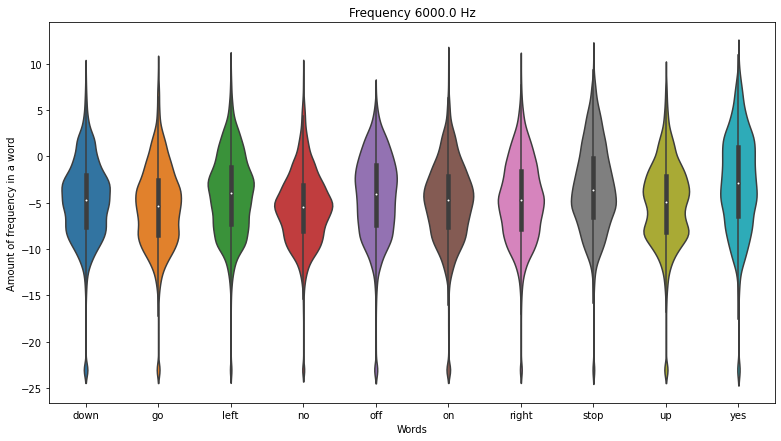

In [37]:
violinplot_frequency(dirs, 120)

## 2.7. Anomaly detection
<a id="anomaly"></a> 

다른 것들보다 눈에 띄는 녹음물이 있는지 확인해봐야 합니다. 데이터 세트의 차원을 낮추고 대화식으로 이상 유무를 확인할 수 있습니다.
차원 축소를 위해 PCA를 사용합니다.


In [38]:
sample_rate, samples = wavfile.read(str(train_audio_path) + filename) # sample_rate = 160000Hz

fft_all = []
names = []
for direct in dirs:
    waves = [f for f in os.listdir(join(train_audio_path, direct)) if f.endswith('.wav')]
    for wav in waves:
        sample_rate, samples = wavfile.read(train_audio_path + direct + '/' + wav)
        if samples.shape[0] != sample_rate:
            samples = np.append(samples, np.zeros((sample_rate - samples.shape[0], )))
        x, val = custom_fft(samples, sample_rate)
        fft_all.append(val)
        names.append(direct + '/' + wav)

fft_all = np.array(fft_all)

# Normalization
fft_all = (fft_all - np.mean(fft_all, axis=0)) / np.std(fft_all, axis=0)

# Dim reduction
pca = PCA(n_components=3)
fft_all = pca.fit_transform(fft_all)

def interactive_3d_plot(data, names):
    scatt = go.Scatter3d(x=data[:, 0], y=data[:, 1], z=data[:, 2], mode='markers', text=names)
    data = go.Data([scatt])
    layout = go.Layout(title="Anomaly detection")
    figure = go.Figure(data=data, layout=layout)
    py.iplot(figure)
    
interactive_3d_plot(fft_all, names)

C:\Users\HOME\anaconda3\lib\site-packages\plotly\graph_objs\_deprecations.py:31: DeprecationWarning:

plotly.graph_objs.Data is deprecated.
Please replace it with a list or tuple of instances of the following types
  - plotly.graph_objs.Scatter
  - plotly.graph_objs.Bar
  - plotly.graph_objs.Area
  - plotly.graph_objs.Histogram
  - etc.




`위의 그림에서 떨어져 있는 이상치를 들어보자. 그 중에서도 yes/e4b02540_nohash_0.wav, go/0487ba9b_nohash_0.wav 의 포인트들은 중앙으로부터 많이 떨어져있다.



In [39]:
print('Recording go/0487ba9b_nohash_0.wav')
ipd.Audio(join(train_audio_path, 'go/0487ba9b_nohash_0.wav'))

Recording go/0487ba9b_nohash_0.wav


In [40]:
print('Recording yes/e4b02540_nohash_0.wav')
ipd.Audio(join(train_audio_path, 'yes/e4b02540_nohash_0.wav'))

Recording yes/e4b02540_nohash_0.wav


위의 소리는 지지직 거리거나 잡음이 많이 껴 있음을 확인할 수 있다.

만약 개별 단어의 이상치가 궁금하다면, seven 폴더에서 찾아볼 수 있다.



In [41]:
print('Recording seven/e4b02540_nohash_0.wav')
ipd.Audio(join(train_audio_path, 'seven/b1114e4f_nohash_0.wav'))

Recording seven/e4b02540_nohash_0.wav


분명히 중요한게 아니지만, 이방법을 사용하면 약간의 왜곡을 발견할 수 있다.



## 3. Where to look for the inspiration
<a id="wheretostart"></a> 

다양한 방법으로 경쟁에 임할 수 있습니다. 그 어떤 조언도 해줄 수 없어요. 저의 초심을 말씀드리겠습니다.

최근 몇 년간 뉴럴 네트워크를 기반으로 한 솔루션을 제안하는 추세가 있습니다. 일반적으로 두 개의 아키텍처가 있습니다. 제 아이디어가 여기 있어요.

1. 인코더-디코더: https://arxiv.org/abs/1508.01211입니다.
2. CTC 손실이 있는 RNN: https://arxiv.org/abs/1412.5567 <br>
특히 SR 분야에 대한 경험이 없는 경우에는 1과 2가 이번 경쟁에서 합리적인 선택입니다. 엔드 투 엔드 솔루션이 되려고 합니다. 음성 인식은 정말 큰 주제이고 짧은 시간 안에 중요한 것들을 알아가는 것은 어려울 것입니다.

3. 고전적인 음성 인식은 http://www.ece.ucsb.edu/Faculty/Rabiner/ece259/Reprints/tutorial%20on%20hmm%20and%20applications.pdf에 설명되어 있습니다.

*Kaldi* [더미를 위한 튜토리얼](http://kaldi-asr.org/doc/kaldi_for_dummies.html),에서 이 대회와 유사한 문제를 찾을 수 있습니다.

4. 매우 깊은 CNN - SR을 위해 사용되는지는 모릅니다. 그러나, 대부분의 논문은 LVCSR(Large Vociety Continuous Speech Recognition Systems)에 관한 것입니다. 우리는 여기서 다른 작업을 했습니다. 매우 적은 어휘와 한 단어만 포함된 녹음과 (대부분) 주어진 길이의 녹음입니다. 그런 접근법이 경쟁에서 이길 수 있을 것 같아요.